model agnostic

In [1]:
# !pip install pip install -U pyartemis

In [2]:
from util_comp import *
from scipy.cluster.hierarchy import dendrogram , linkage , fcluster
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from artemis.interactions_methods.model_agnostic import FriedmanHStatisticMethod
from time import time

import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import random
import warnings

warnings.filterwarnings("ignore")

In [3]:
data = main(one_hot=True)

Elapsed time to compute age categorisation: 0 minutes and 0 seconds
Elapsed time to compute correct systematic error: 0 minutes and 11 seconds
Elapsed time to compute load column names: 0 minutes and 0 seconds
Elapsed time to compute complete MICE imputation: 1 minutes and 11 seconds
Elapsed time to compute categorisation of outcome column: 0 minutes and 3 seconds
Elapsed time to compute change values in catagorical columns: 1 minutes and 57 seconds
Elapsed time to compute OneHotEncoding: 0 minutes and 1 seconds
Elapsed time to compute Full process: 3 minutes and 23 seconds


In [4]:
# Splitting the data into X and y
X = data[(data['outcome'] == 0) | (data['outcome'] == 1)].drop('outcome',axis=1)
X.columns = [str(col) for col in X.columns]
y = data[(data['outcome'] == 0) | (data['outcome'] == 1)]['outcome']

In [5]:
# RF model
rf = RandomForestClassifier(class_weight='balanced')

rf.fit(X, y)

RandomForestClassifier()

Fedmans H Statistics

In [6]:
# Get random selection of 100 observations

random.seed(42)
X_exp = random.choices(X.to_numpy(), k=100)
X_exp = pd.DataFrame(X_exp, columns=X.columns)

In [7]:
h_stat = FriedmanHStatisticMethod()
t1 = time()
h_stat.fit(rf, X_exp)
t2 = time()
print(time_e(t1, t2, 'Friedman H Statistic'))

Elapsed time to compute Friedman H Statistic: 81 minutes and 6 seconds


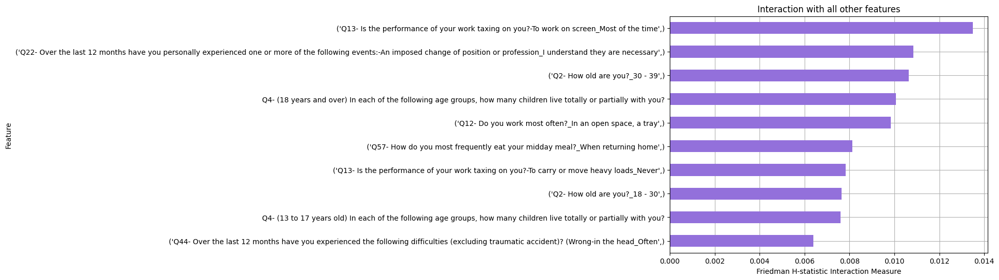

In [8]:
# Overall interactions
# fig, ax = plt.subplots(figsize=(20, 12))
h_stat.plot(vis_type='bar_chart_ova') # (, ax=ax)

# save the plot
plt.savefig('outputs/01_02_01_hStat/hStat_OverAll.png', bbox_inches='tight')

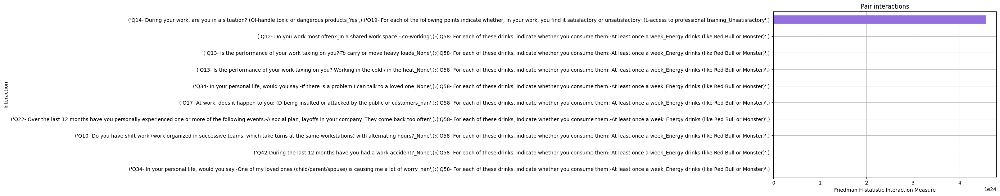

In [9]:
# Pairwise interactions
# fig, ax = plt.subplots(figsize=(20, 12))
h_stat.plot(vis_type='bar_chart') # (, ax=ax)

# save the plot
plt.savefig('outputs/01_02_01_hStat/hStat_Pairwise.png', bbox_inches='tight')

In [30]:
h_stat.feature_importance[:20]

,Feature,Importance
0,('Q22- Over the last 12 months have you person...,0.017250
1,('Q42-During the last 12 months have you had a...,0.013750
2,('Q57- How do you most frequently eat your mid...,0.011550
3,('Q42-During the last 12 months have you had a...,0.010450
4,('Q22- Over the last 12 months have you person...,0.008900
5,('Q63- Over the past 12 months have you experi...,0.008800
6,('Q23- Do you have difficulty reconciling your...,0.008550
7,('Q12- Do you work most often?_In an open spac...,0.008400
8,Q4- (18 years and over) In each of the followi...,0.008235
9,('Q44- Over the last 12 months have you experi...,0.007650


In [10]:
# Interaction heatmap
h_stat.plot(figsize=(100, 60))

# save the plot
plt.savefig('outputs/01_02_01_hStat/hStat_Heatmap_normalised.png', bbox_inches='tight')

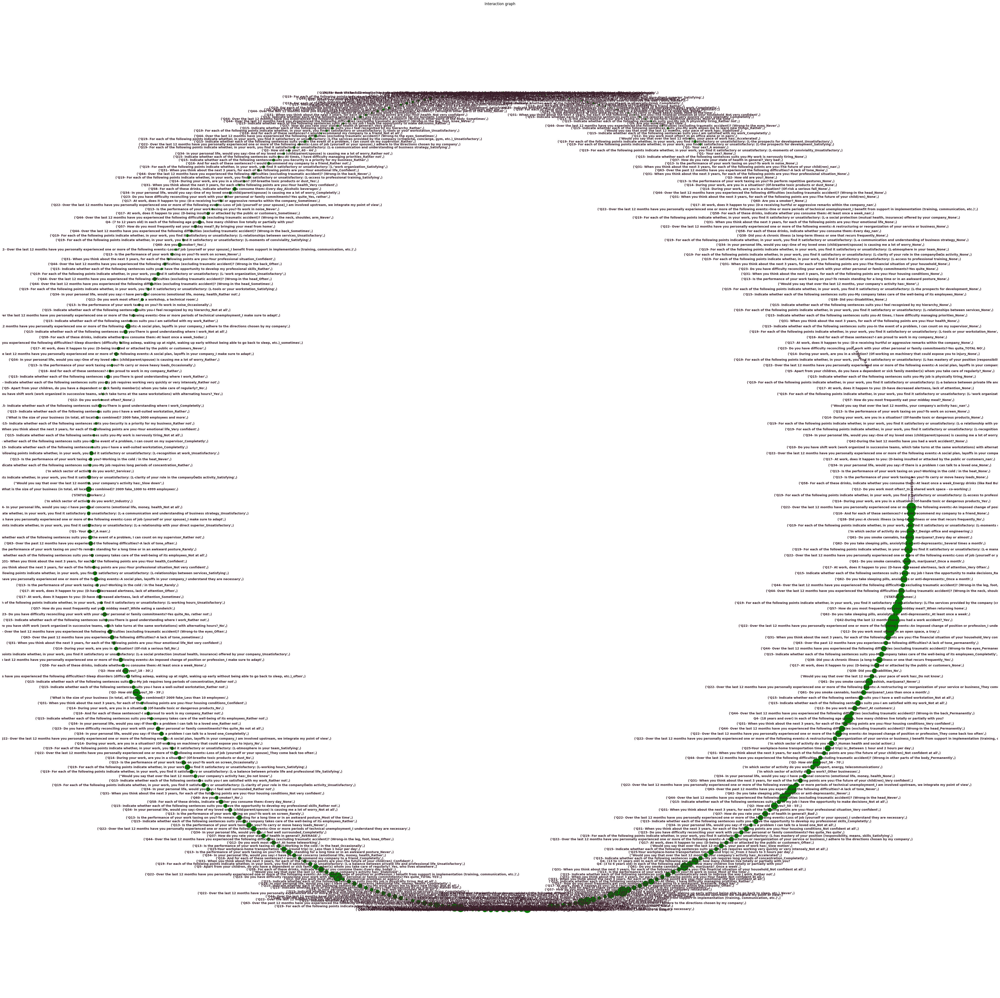

In [26]:
h_stat.plot(vis_type='graph', figsize=(60,60)) # (, ax=ax)

# save the plot
plt.savefig('outputs/01_02_01_hStat/hStat_graph.png', bbox_inches='tight')

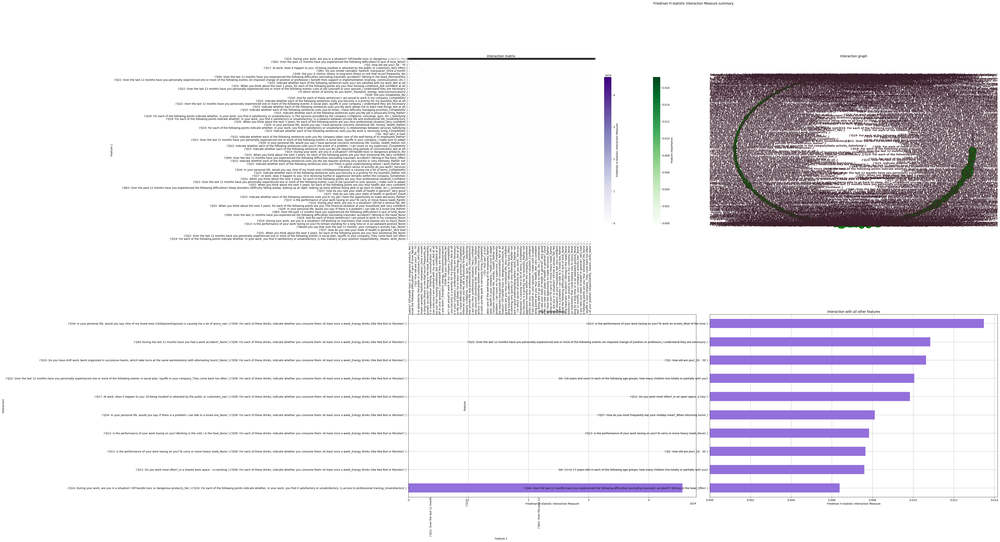

In [17]:
h_stat.plot(vis_type='summary') # (, ax=ax)

# save the plot
plt.savefig('outputs/01_02_01_hStat/hStat_summary.png', bbox_inches='tight')

Unnormalised H-Statistic

In [11]:
h_stat_unnormalised = FriedmanHStatisticMethod(normalized=False)
t1 = time()
h_stat_unnormalised.fit(rf, X_exp)
t2 = time()
print(time_e(t1, t2, 'Friedman H Statistic unnormalised'))

Elapsed time to compute Friedman H Statistic unnormalised: 103 minutes and 54 seconds


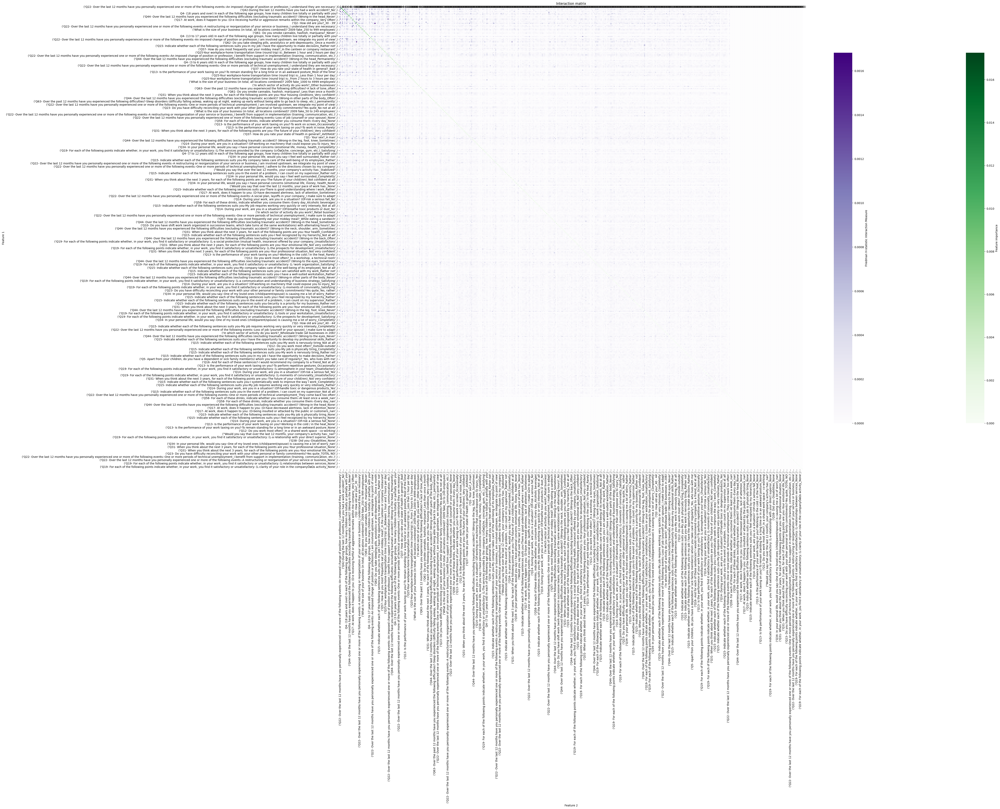

In [12]:
# Plot heatmap
fig, ax = plt.subplots(figsize=(50, 30))
h_stat_unnormalised.plot(ax=ax)

# save the plot
fig.savefig('outputs/01_02_01_hStat/hStat_heatmap_unnormalised.png', bbox_inches='tight')

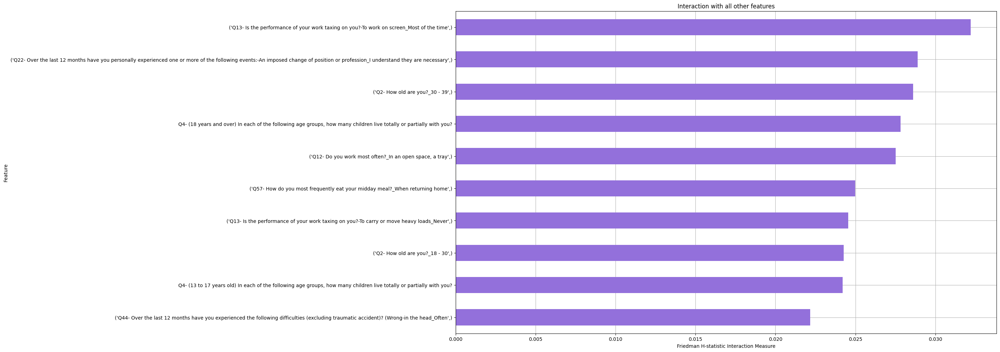

In [13]:
# Plot overall interactions
fig, ax = plt.subplots(figsize=(20, 12))
h_stat_unnormalised.plot(vis_type='bar_chart_ova', ax=ax)

# save the plot
plt.savefig('outputs/01_02_01_hStat/overall_interactions_unnormalised.png', bbox_inches='tight')

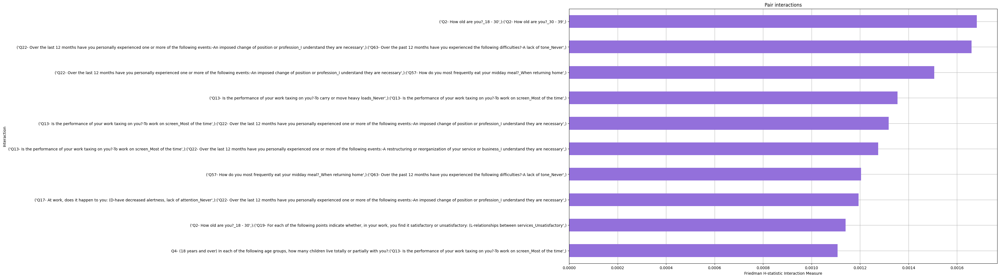

In [25]:
# Plot pairwise interactions
fig, ax = plt.subplots(figsize=(20, 12))
h_stat_unnormalised.plot(vis_type='bar_chart', ax=ax)

# save the plot
plt.savefig('outputs/01_02_01_hStat/pairwise_interactions_unnormalised.png', bbox_inches='tight')

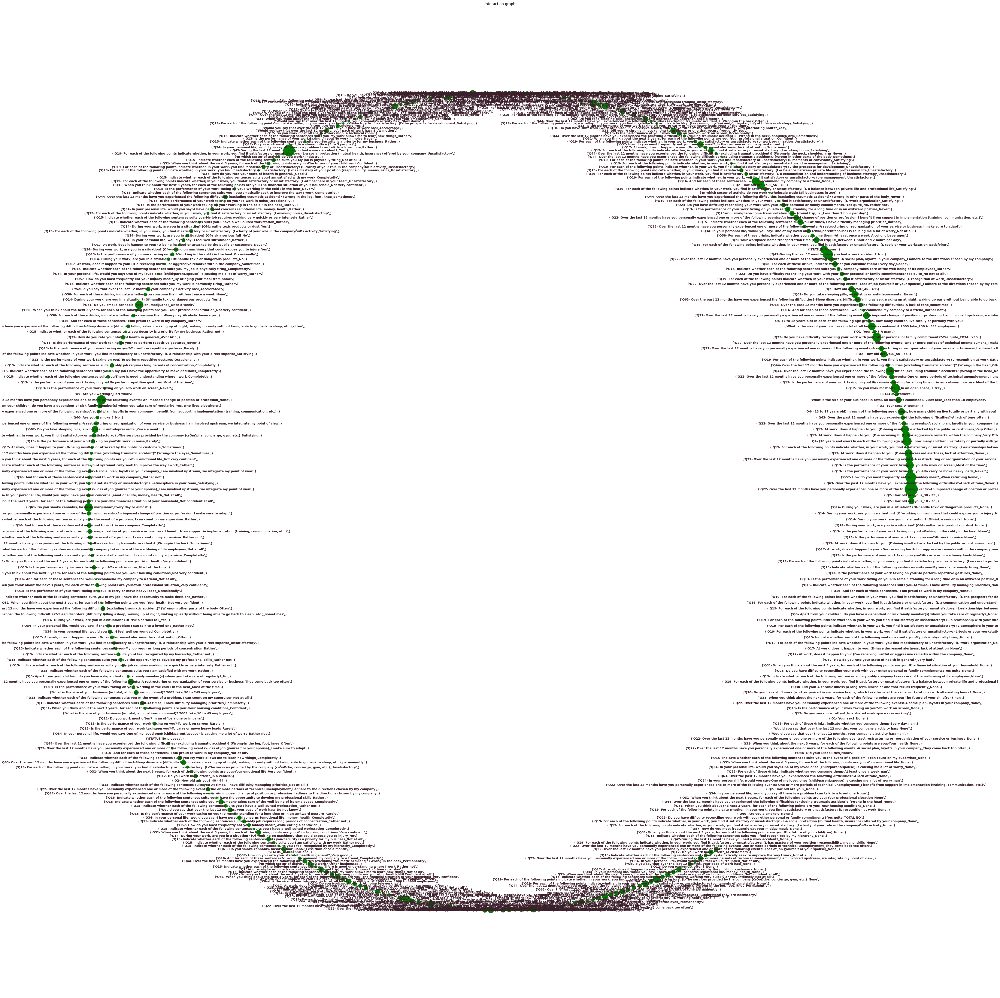

In [23]:
h_stat_unnormalised.plot(vis_type='graph', figsize=(60,60)) # graph of feature interactions values

# save the plot
plt.savefig('outputs/01_02_01_hStat/hStat_un_graph.png', bbox_inches='tight')

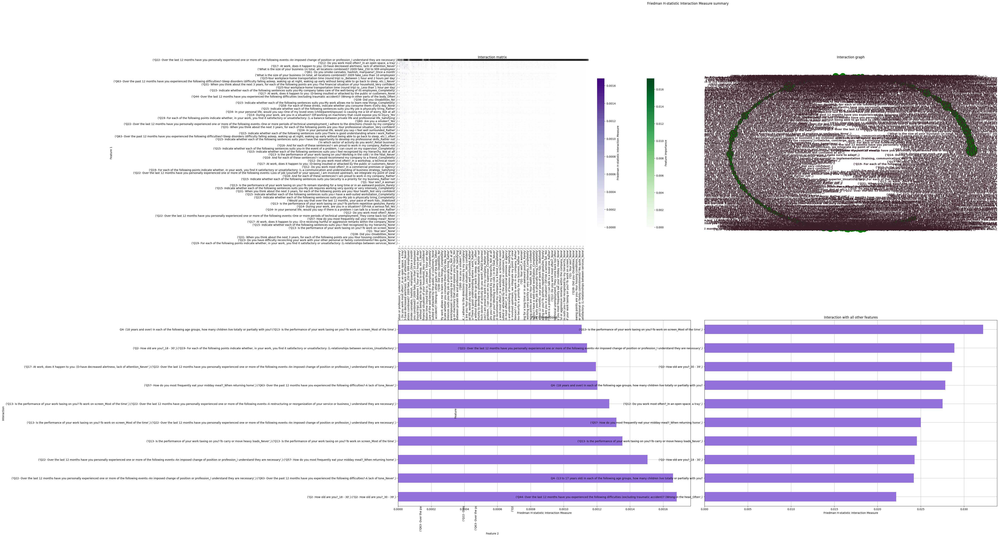

In [19]:
h_stat_unnormalised.plot(vis_type='summary') # (, ax=ax)

# save the plot
plt.savefig('outputs/01_02_01_hStat/hStat_un_summary.png', bbox_inches='tight')

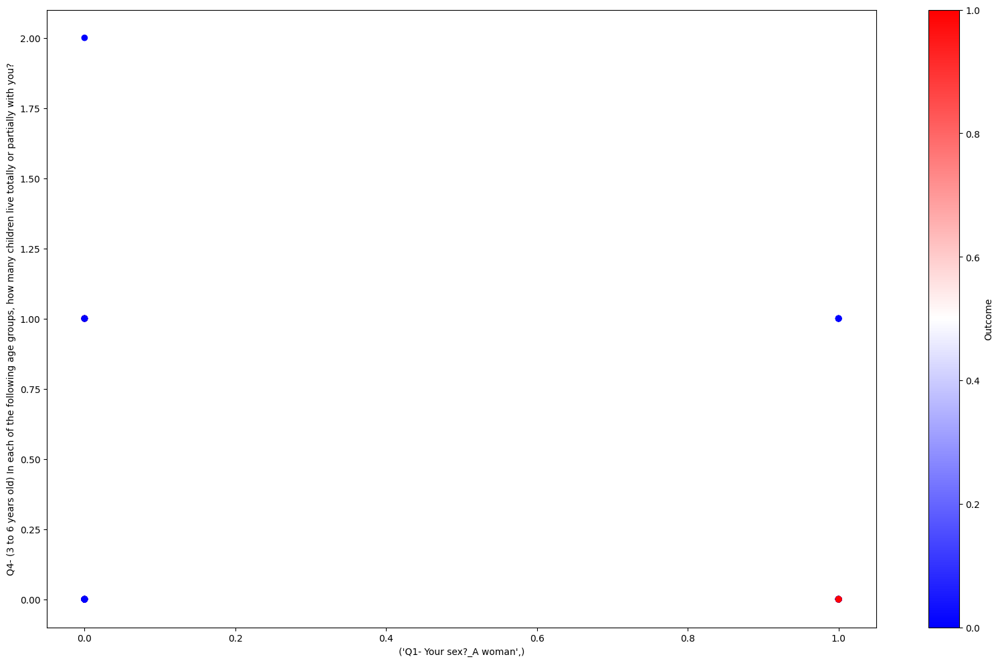

In [15]:
# Interaction between two features
fig, ax = plt.subplots(figsize=(20, 12))
plt.scatter(X_exp["('Q1- Your sex?_A woman',)"], X_exp["Q4- (3 to 6 years old) In each of the following age groups, how many children live totally or partially with you?"], c=y[:100], cmap='bwr')
plt.colorbar(label='Outcome', orientation='vertical')
plt.xlabel("('Q1- Your sex?_A woman',)")
plt.ylabel("Q4- (3 to 6 years old) In each of the following age groups, how many children live totally or partially with you?")
plt.savefig('outputs/01_02_01_hStat/interaction_between_two_features.png', bbox_inches='tight')
plt.show()

In [28]:
h_stat_unnormalised.feature_importance[:20]

,Feature,Importance
0,('Q22- Over the last 12 months have you person...,0.017250
1,('Q42-During the last 12 months have you had a...,0.013750
2,('Q57- How do you most frequently eat your mid...,0.011550
3,('Q42-During the last 12 months have you had a...,0.010450
4,('Q22- Over the last 12 months have you person...,0.008900
5,('Q63- Over the past 12 months have you experi...,0.008800
6,('Q23- Do you have difficulty reconciling your...,0.008550
7,('Q12- Do you work most often?_In an open spac...,0.008400
8,Q4- (18 years and over) In each of the followi...,0.008235
9,('Q44- Over the last 12 months have you experi...,0.007650
